In [3]:
import pandas as pd
import plotly.graph_objects as go
import seaborn as sns
from matplotlib import pyplot as plt


In [4]:
import plotly.express as px

In [5]:
url = 'https://raw.githubusercontent.com/owid/covid-19-data/master/public/data/owid-covid-data.csv'
data = pd.read_csv(url)
data['date'] = pd.to_datetime(data['date'])
datafilled = data.fillna(0)

In [6]:
data['date'] = pd.to_datetime(data['date']).dt.date


In [7]:
import plotly.express as px

df= px.data.gapminder().query("country=='Hungary'")
fig=px.line(df,x="year",y="lifeExp",title="Várható élettartam Magyarországon")
fig.show()

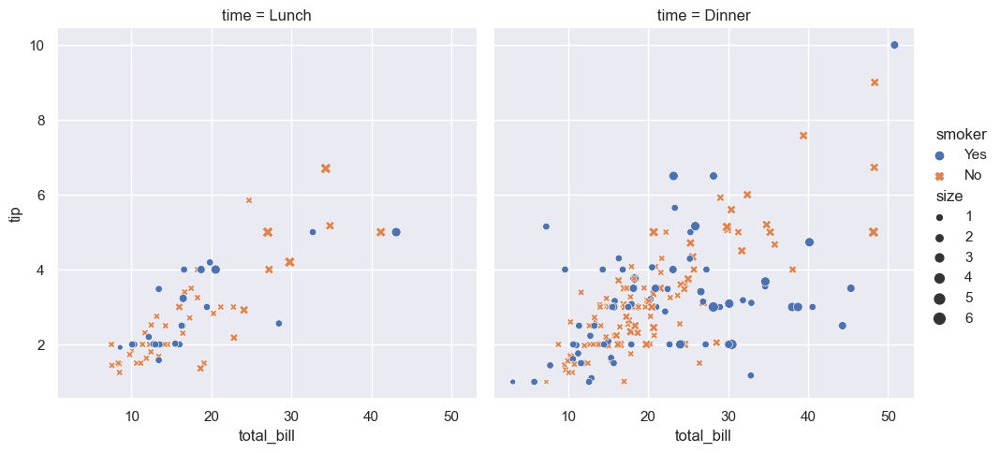

In [8]:
import seaborn as sns
sns.set_theme()
tips=sns.load_dataset("tips")
sns.relplot(
    data=tips,
    x="total_bill",y="tip",col="time",
    hue="smoker",style="smoker",size="size"
);

In [9]:
def map_choropleth(data,column,title,label):
    fig = px.choropleth(data,
                     locations="location",
                     locationmode="country names",
                     color=column,
                     color_continuous_scale="matter",
                     width=1400,height=700,
                     labels={ column: label}
                     )
    fig.update_layout(title=title,
                    title_x=0.5,
                    title_font_size=30,
                    )
    fig.show()


In [10]:
data_death_per_case = data[["location","total_deaths","total_cases"]].copy()
data_death_per_case = data_death_per_case.groupby("location")[["total_deaths","total_cases"]].last().reset_index()
data_death_per_case["deaths_per_100_cases"] = data_death_per_case["total_deaths"] / data_death_per_case["total_cases"] * 100
data_death_per_case_except_yemen = data_death_per_case[data_death_per_case["location"]!="Yemen"]

In [11]:
map_choropleth(data=data_death_per_case_except_yemen,
               column="deaths_per_100_cases",
               title="Halálozási arány az egyes országokban (Kivéve Jemen)",
               label="Halálozási arány (%)")


In [12]:
total_cases = data[["location","total_cases_per_million"]].copy()
total_cases = total_cases.groupby('location')["total_cases_per_million"].last().reset_index()

In [13]:
map_choropleth(data=total_cases,
               column="total_cases_per_million",
               title="A járvány súlyosságának mértéke",
               label="Összes eset/ 1 millió ember")


In [14]:
new_death_data = data[["date","location","new_deaths_per_million"]].copy()

In [15]:
fig = px.choropleth(new_death_data,
                    locations="location",
                    locationmode="country names",
                    color="new_deaths_per_million",
                    color_continuous_scale="Mint",
                    width=1400,height=700,
                    labels={ "new_deaths_per_million": "Új haláleset/1 millió fő"},
                    animation_frame='date',
                    )
fig.update_layout(title="Napi halálesetek 1 millió főre vetítve",
                title_x=0.5,
                title_font_size=30,
                )
fig.show()

In [16]:
df_world = data.loc[data["location"]=="World"]
fig = px.line(df_world,
                x="date",
                y="new_cases_smoothed",
                labels={
                     "new_cases_smoothed": "Új esetek",
                     "date": "Dátum",
                     },
                width=1200,
                height=800
)
fig.update_layout(
    title="Új esetek a Földön",
    title_x=0.5,
)
fig.show()

In [17]:
avg_cases_per_million = df_world.groupby('iso_code')[["new_cases_per_million"]].sum().values[0]
print(avg_cases_per_million[0])

95767.366


In [18]:
continents=["OWID_AFR","OWID_EUR","OWID_ASI","OWID_NAM","OWID_OCE","OWID_SAM"] 
cont_data = data.loc[data["iso_code"].isin(continents)]
cont_data_sum = cont_data.groupby(['location'])[["new_cases","new_deaths","new_cases_per_million"]].sum().reset_index()
cont_data_sum = cont_data_sum.sort_values(by="new_cases")

In [19]:
from plotly.subplots import make_subplots

In [20]:
fig = make_subplots(rows=1, cols=2)
fig.add_trace(
    go.Bar(x=cont_data_sum["new_cases"],
            y=cont_data_sum["location"],
            orientation='h',
            name="Összes esetszám"),
    row=1, col=1
)

fig.add_trace(
    go.Bar(x=cont_data_sum["new_cases_per_million"],
            y=cont_data_sum["location"],
            orientation='h',
            name="Összes esetszám 1 millió emberre vetítve"),
    row=1, col=2
)
fig.update_layout(title="Összes eset",barmode='stack', xaxis={'categoryorder': 'total descending'},title_x=0.5)
fig.show()

In [21]:
fig = px.choropleth(datafilled,
                     locations="iso_code",
                     color="gdp_per_capita",
                     )
fig.update_geos(showcountries=True,scope='europe')
fig.update_layout(title="Total cases by country (cases/million ppl)",
                  title_x=0.5,
                  margin={"r":0,"t":50,"l":0,"b":0},
                  height=600,
                  )
fig.show()

In [22]:
hospital_data = data.loc[data["continent"]=="Europe"][["location","total_deaths_per_million","hospital_beds_per_thousand"]]
hospital_data = hospital_data.groupby(["location"])[["total_deaths_per_million","hospital_beds_per_thousand"]].last().reset_index()
hospital_data= hospital_data.rename(columns={"new_deaths_per_million":"total_deaths_per_million"})
hospital_data = hospital_data.loc[(hospital_data["total_deaths_per_million"].notna()) & (hospital_data["hospital_beds_per_thousand"].notna())].sort_values(by="hospital_beds_per_thousand",ascending=False)
high_hospital_data = hospital_data.head(10)
low_hospital_data = hospital_data.tail(10)

C:\Users\Balazs\AppData\Local\Temp\ipykernel_19528\3023699227.py:20: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



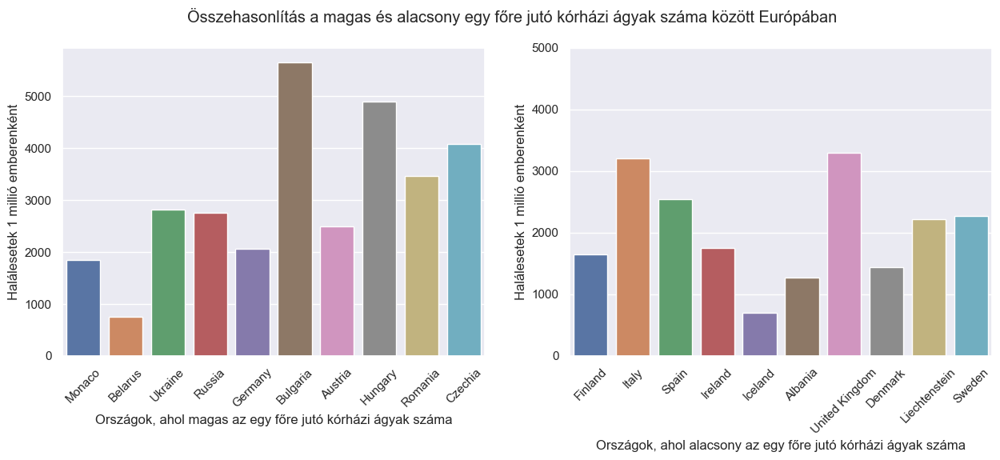

In [23]:
fig, ax = plt.subplots(1,2,figsize=(15,5))
high_hospital_plot= sns.barplot(
    ax=ax[0],
    data=high_hospital_data,
    x="location",
    y="total_deaths_per_million",
)
high_hospital_plot.set(xlabel="Országok, ahol magas az egy főre jutó kórházi ágyak száma",ylabel="Halálesetek 1 millió emberenként")
low_hospital_plot=sns.barplot(
    ax=ax[1],
    data=low_hospital_data,
    x="location",
    y="total_deaths_per_million",
)
low_hospital_plot.set(xlabel="Országok, ahol alacsony az egy főre jutó kórházi ágyak száma",ylabel="Halálesetek 1 millió emberenként")
plt.setp(high_hospital_plot.get_xticklabels(), rotation=45)
plt.setp(low_hospital_plot.get_xticklabels(), rotation=45)
fig.suptitle("Összehasonlítás a magas és alacsony egy főre jutó kórházi ágyak száma között Európában")
plt.ylim(0,5000)
fig.show()

In [24]:
continent_cases = data[["date","continent","new_cases_smoothed_per_million"]].copy()
continent_cases = continent_cases.groupby(["date","continent"])["new_cases_smoothed_per_million"].sum().reset_index()

In [25]:
fig = px.line(continent_cases,
              x="date",
              y="new_cases_smoothed_per_million",
              color="continent",
              labels={
                     "date": "Dátum",
                     "new_cases_smoothed_per_million": "Új esetek 1 millió főre vetítve",
                     "continent": "Kontinensek"
                 })
fig.update_layout(title="Napi új esetszámok kontinensekre bontva",
                  title_x=0.5,
                  )
fig.show()

In [26]:
hun_response_data = data[["date","location","stringency_index","new_cases_smoothed_per_million"]].copy()
hun_response_data = hun_response_data.loc[hun_response_data["stringency_index"].notna()].loc[hun_response_data["location"]=="Hungary"]

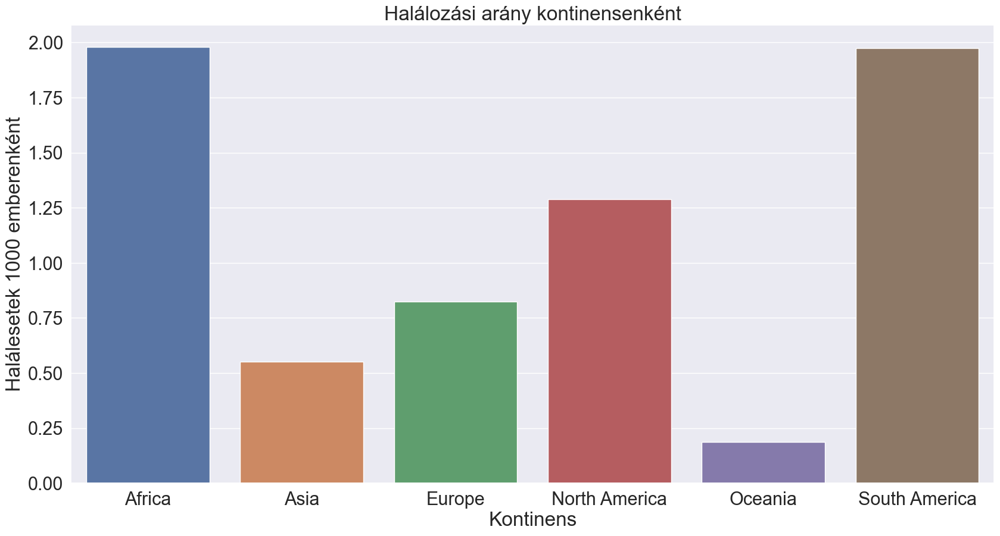

In [27]:
cont_death_per_case = cont_data[["location","total_cases_per_million","total_deaths_per_million"]].groupby(by="location").last().reset_index()
cont_death_per_case["deaths_per_100_cases"] = cont_death_per_case["total_deaths_per_million"] / cont_death_per_case["total_cases_per_million"] * 100
sns.set(rc={'figure.figsize':(20,10)},font_scale=2)
ax=sns.barplot(cont_death_per_case,
            x="location",
            y="deaths_per_100_cases").set(title="Halálozási arány kontinensenként",
            xlabel="Kontinens",
            ylabel="Halálesetek 1000 emberenként");


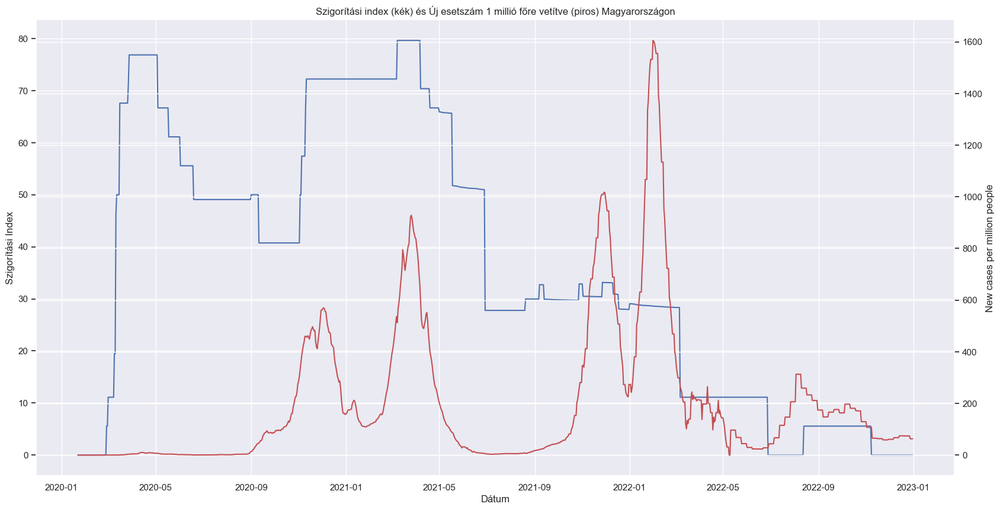

In [28]:
sns.set_theme()
sns.lineplot(data=hun_response_data,
             x="date",
             y="stringency_index").set(
            title="Szigorítási index (kék) és Új esetszám 1 millió főre vetítve (piros) Magyarországon",
            xlabel="Dátum",
            ylabel="Szigorítási Index")
ax2 = plt.twinx()
sns.lineplot(data=hun_response_data, 
             x="date",
             y="new_cases_smoothed_per_million",
            color="r", 
            ax=ax2).set(ylabel="New cases per million people")
sns.set(rc={'figure.figsize':(20,10)},font_scale=2)
plt.show()

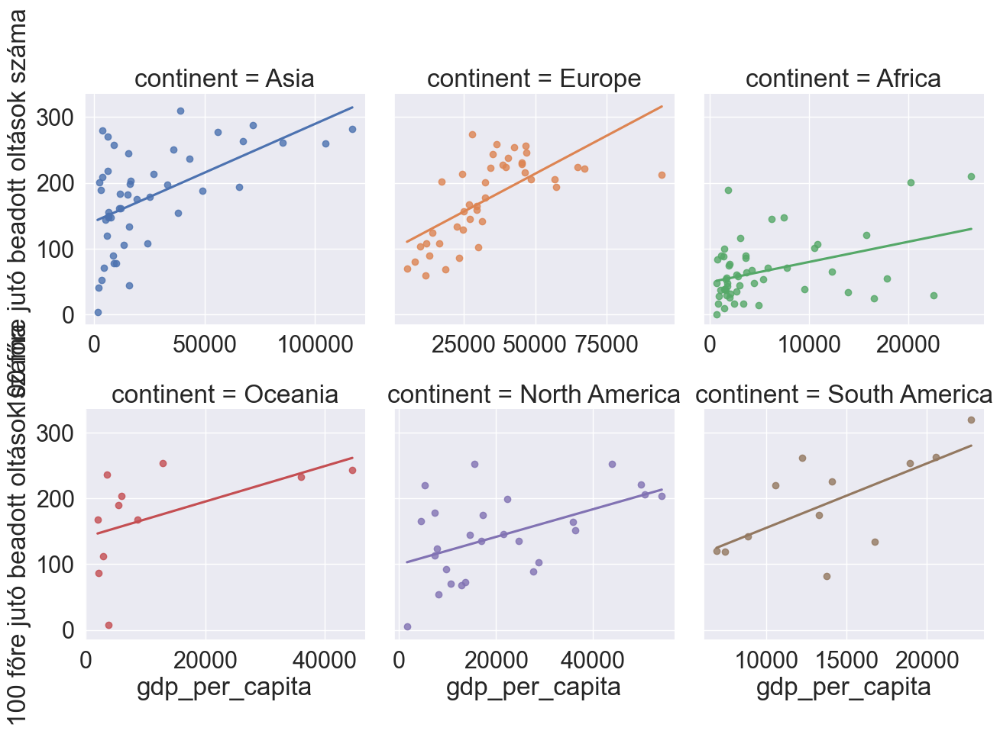

In [29]:
data_vacc_gdp = data[["location","continent","gdp_per_capita","total_vaccinations_per_hundred"]].copy()
data_vacc_gdp = data_vacc_gdp.groupby("location")[["continent","gdp_per_capita","total_vaccinations_per_hundred"]].last()
sns.lmplot(data=data_vacc_gdp,
            x="gdp_per_capita",
            y="total_vaccinations_per_hundred",
            hue="continent",
            col="continent",
            col_wrap=3,
            ci=None,
            height=4.5,
            facet_kws=dict(sharex=False)
            ).set(ylabel="100 főre jutó beadott oltások száma");

In [30]:
data_death_per_case = data[["location","continent","total_deaths","total_cases","human_development_index"]].copy()
data_death_per_case = data_death_per_case.groupby("location")[["continent","total_deaths","total_cases","human_development_index"]].last().reset_index()
data_death_per_case["deaths_per_100_cases"] = data_death_per_case["total_deaths"] / data_death_per_case["total_cases"] * 100

In [31]:
px.scatter(data_death_per_case,
           y="deaths_per_100_cases",
           x='human_development_index',
           color='continent',
           height=800,
           hover_name="location",
           color_discrete_sequence=px.colors.qualitative.D3,
           trendline="ols")

In [32]:
data_count = data.count().reset_index().rename(columns={0:"count","index":"col"})
data_count

,col,count
0,iso_code,304585
1,continent,290085
2,location,304585
3,date,304585
4,total_cases,268489
...,...,...
62,population,304585
63,excess_mortality_cumulative_absolute,10669
64,excess_mortality_cumulative,10669
65,excess_mortality,10669


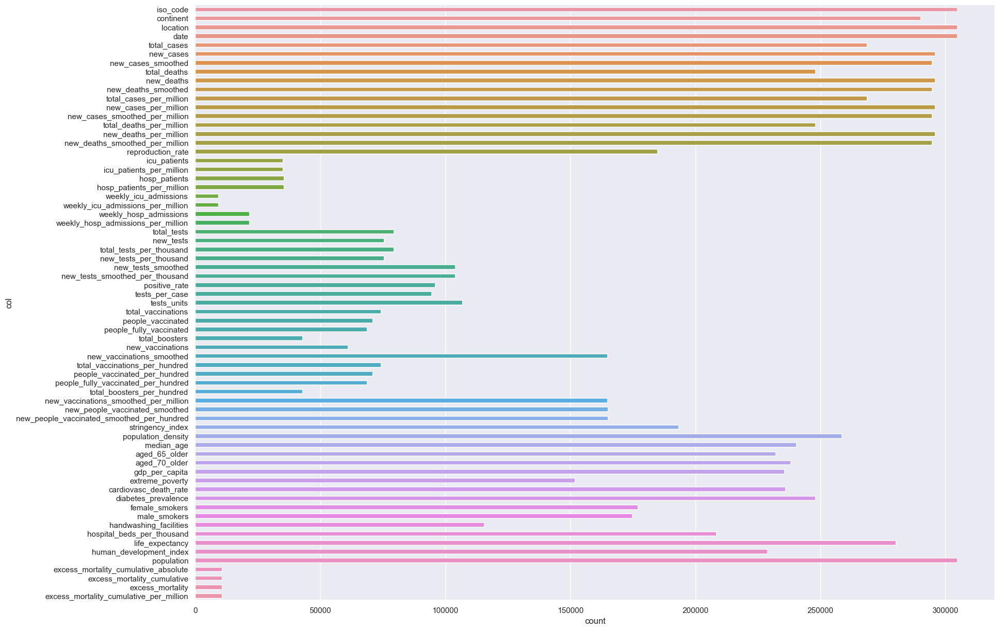

In [33]:
sns.set(rc={'figure.figsize':(20,15)})
sns.barplot(
    data=data_count,
    x="count",
    y="col",
    width=0.5,
    units="col"
);

In [34]:
most_cases = data.loc[data["continent"].notna()][['location', 'total_cases']].copy()
most_cases = most_cases.groupby(['location']).max().sort_values('total_cases', ascending=False).head(10).reset_index()

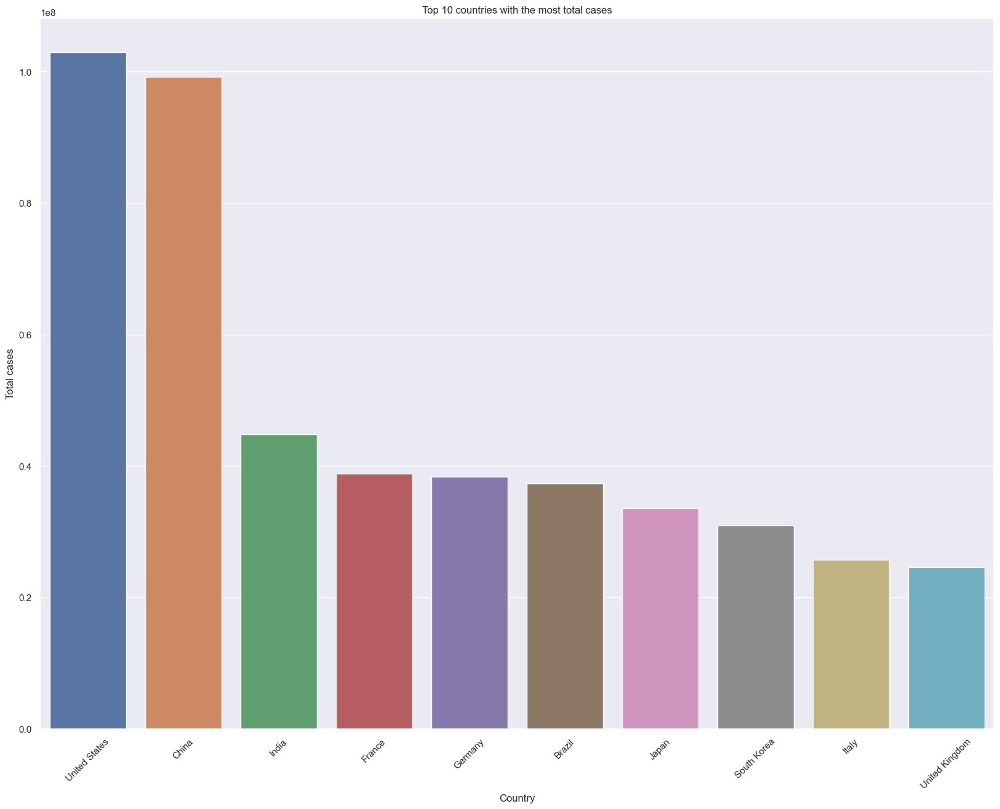

In [35]:
sns.barplot(x='location', y='total_cases', data=most_cases)
plt.title('Top 10 countries with the most total cases')
plt.ylabel('Total cases')
plt.xlabel('Country')
plt.xticks(rotation=45)
plt.show()

In [36]:
most_death_per_case = data[["location","new_cases_per_million","new_deaths_per_million"]].groupby(by="location").sum().reset_index()
most_death_per_case = most_death_per_case.rename(columns={"new_cases_per_million":"total_cases_per_million","new_deaths_per_million":"total_deaths_per_million"})
most_death_per_case["deaths_per_100_cases"] = most_death_per_case["total_deaths_per_million"] / most_death_per_case["total_cases_per_million"] *100
most_death_per_case = most_death_per_case.groupby(['location']).max().sort_values('deaths_per_100_cases', ascending=False).head(10).reset_index()

most_death_per_case

,location,total_cases_per_million,total_deaths_per_million,deaths_per_100_cases
0,Yemen,354.482,64.079,18.076799
1,Sudan,1365.180,107.641,7.884748
2,Syria,2595.357,142.991,5.509493
3,Somalia,1553.291,77.347,4.979556
4,Peru,132069.014,6460.904,4.892067
5,Egypt,4648.785,223.607,4.810009
6,Mexico,59320.257,2616.957,4.411574
7,Bosnia and Herzegovina,124541.586,5050.847,4.055551
8,Afghanistan,5183.537,191.704,3.698324
9,Liberia,1525.910,55.655,3.647332


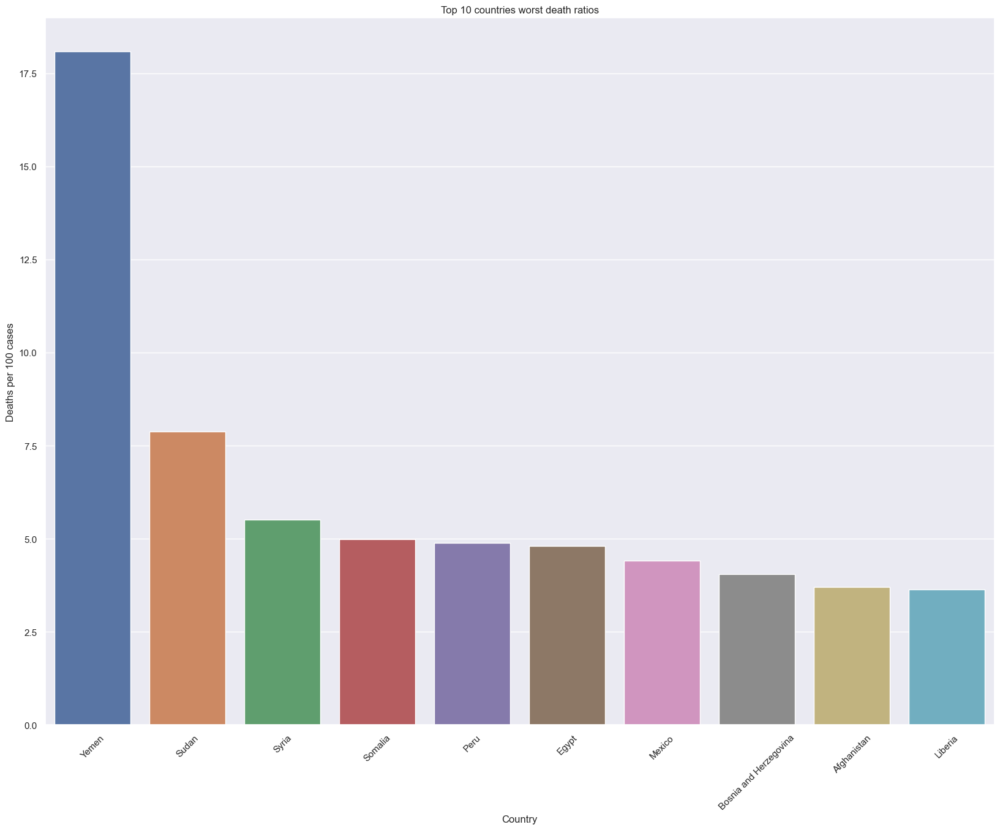

In [37]:
sns.set_theme()
sns.barplot(x='location', y='deaths_per_100_cases', data=most_death_per_case)
plt.title('Top 10 countries worst death ratios')
plt.ylabel('Deaths per 100 cases')
plt.xlabel('Country')
plt.xticks(rotation=45)
plt.show()

In [38]:
hun_data = data[data["location"]=="Hungary"][["date","new_cases","new_vaccinations"]]

In [39]:
cont_vacc = data.groupby(by="continent").sum()["total_vaccinations_per_hundred"].reset_index()
cont_vacc

,continent,total_vaccinations_per_hundred
0,Africa,181927.85
1,Asia,2075716.17
2,Europe,3060213.32
3,North America,928512.32
4,Oceania,251500.54
5,South America,827451.90


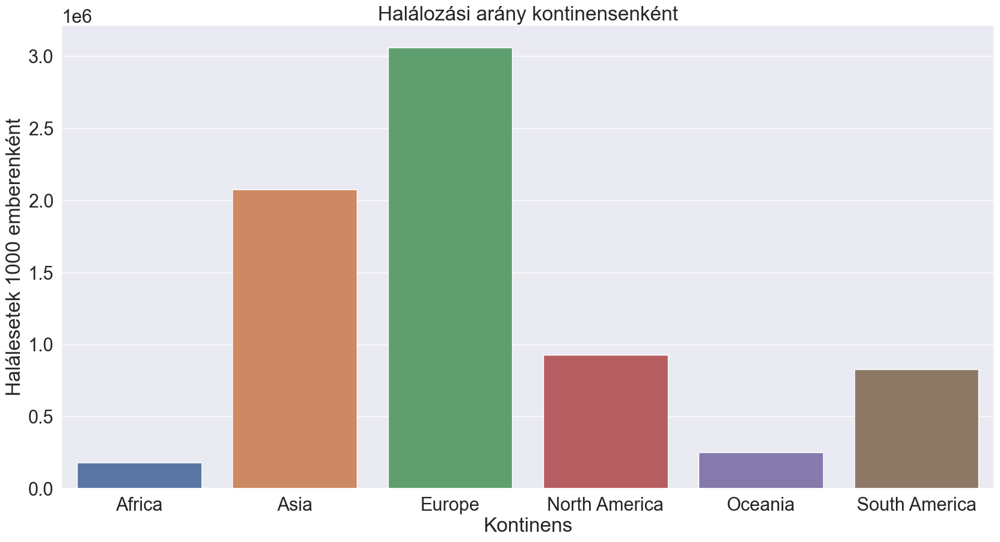

In [40]:


sns.set(rc={'figure.figsize':(20,10)},font_scale=2)

sns.barplot(cont_vacc,
            x="continent",
            y="total_vaccinations_per_hundred").set(title="Halálozási arány kontinensenként",
            xlabel="Kontinens",
            ylabel="Halálesetek 1000 emberenként");


In [41]:
hun_vacc_data = data[(data["location"]=="Hungary") & data["positive_rate"].notna()][["date","new_tests_smoothed","new_cases_smoothed"]].set_index("date")
hun_vacc_data = hun_vacc_data.rename(columns={"new_tests_smoothed":"Új tesztek","new_cases_smoothed":"Új esetek"})

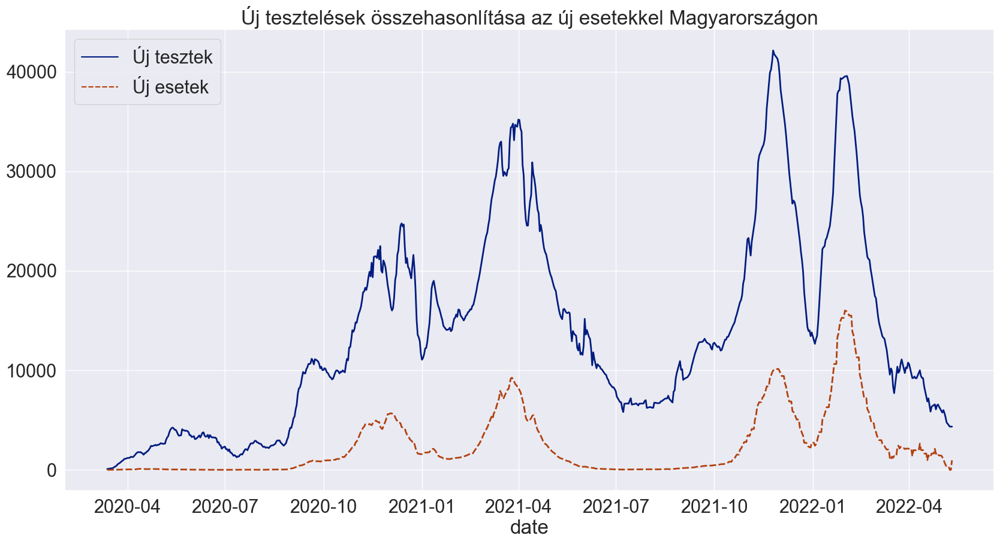

In [42]:
sns.set(font_scale=2)
sns.lineplot(data=hun_vacc_data,
             linewidth=2,
             palette="dark").set(title="Új tesztelések összehasonlítása az új esetekkel Magyarországon");

In [73]:
total_cases_breakdown = data[data["continent"].notna()].groupby(["continent","location"]).last()[["new_cases"]].reset_index()
total_cases_breakdown

,continent,location,new_cases
0,Africa,Algeria,0.0
1,Africa,Angola,0.0
2,Africa,Benin,0.0
3,Africa,Botswana,0.0
4,Africa,Burkina Faso,0.0
...,...,...,...
238,South America,Paraguay,0.0
239,South America,Peru,4005.0
240,South America,Suriname,0.0
241,South America,Uruguay,936.0


In [78]:
fig = px.sunburst(total_cases_breakdown,
                    path=['continent', 'location'],
                    values="new_cases",
                    color_discrete_sequence=px.colors.sequential.Sunsetdark,
            )
fig.update_layout(title="COVID-19 esetek földrészekre bontva",
                  title_x=0.5,
                  title_font_size=30,
                  width=800,
                  height=800)


fig.show()

In [84]:
fig = px.scatter_geo(
    data=data
    template="plotly_dark")

fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()